In [1]:
# !pip install transformers   #Installare libreria transformers per usare librerie di Bert
# !pip install wandb

In [2]:
import sys

sys.path.append('/home/michieletto/hmp_utils')
if '../' not in sys.path:
    sys.path.append('../')

In [3]:
import json
import glob
import os
import random

from hmp_utils.motion.body_models_constants import SmplConstants
from hmp_utils.motion.mocap_processor import MocapLoader
from hmp_utils.motion.kinematics import ForwardKinematics
from hmp_utils.visualize.stickman_animation import pose_animation, CameraOrientation, AnimationMode

import torch
from transformers import BertModel, BertTokenizer, AdamW, get_linear_schedule_with_warmup
from torch.utils.data import Dataset, DataLoader

from sklearn.model_selection import train_test_split
import torch.nn as nn
import torch.optim as optim
import tqdm
import numpy as np
import pandas as pd
import wandb
import re
import time

In [4]:
wandb.login()

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


wandb: Currently logged in as: pietro-mercorella (csquare). Use `wandb login --relogin` to force relogin


True

Creazione del dataset Amass ed estrazione random di un file per verificare se e come viene descritto da Babel (valutando se i percorsi file /ultima_cartella/nome_file.npz corrispondono)

In [5]:

directory = '/home/michieletto/datasets/AMASS_H/KIT'
file_paths = glob.glob(directory + '/**/*.npz', recursive=True)

file_paths = sorted(file_paths)
print(len(file_paths))

occur_lab = []
deleted = []
for i,file in enumerate(file_paths):
    file_name = os.path.basename(file)    # ottiene il nome del file

    # Controlla se la stringa inizia con una lettera
    if re.match(r'^[a-zA-Z]', file_name):
        # Estrarre la parte della stringa fino al primo numero
        match = re.match(r'^[^\d]+', file_name)
        if match:
            result = match.group()

        # Sostituire gli underscore con spazi vuoti
        result = result.replace('_', ' ')
        result = re.sub(r'(?<!^)(?=[A-Z])', ' ', result)

        occur_lab.append(result)
    else:
        deleted.append(i)

print(len(occur_lab))

for i in sorted(deleted, reverse=True):
    del file_paths[i]

print(len(file_paths))


4232
4200
4200


In [6]:
# Set the model name
MODEL_NAME = 'bert-base-cased'

# Build a BERT based tokenizer
tokenizer = BertTokenizer.from_pretrained(MODEL_NAME)

# Store length of each review
max = 0
for txt in occur_lab:
    tokens = tokenizer.encode(txt, max_length=512)  #Capire la scelta del numero
    if len(tokens) > max:
        max = len(tokens)

print(max)

Truncation was not explicitly activated but `max_length` is provided a specific value, please use `truncation=True` to explicitly truncate examples to max length. Defaulting to 'longest_first' truncation strategy. If you encode pairs of sequences (GLUE-style) with the tokenizer you can select this strategy more precisely by providing a specific strategy to `truncation`.


11


Creazione del MocapLoader ed estrazione dai file di Amass i frame in forma di matrici 24x3. Successivamente c'è la visualizzazione del primo frame del mocap estratto precedentemente ed il suo viedo.

In [9]:

# -- load mocap --
mocap_loader=MocapLoader(body_model_type=SmplConstants.BODY_MODEL_TYPE,
                         keypoint_ids_to_load=SmplConstants.KEYPOINTS,
                         target_framerate = 25)

motions = []
motions = [mocap_loader.load_mocap(path) for path in file_paths]     # lista delle classi di tutti i mocap

# -- compute joint positions --
kine = ForwardKinematics(SmplConstants.OFFSETS, SmplConstants.PARENTS)
kine.set_body_model_type(SmplConstants.BODY_MODEL_TYPE)

for i in range(10):
    rand_x = random.randint(0, len(file_paths))
    motion = motions[rand_x]     # selezione casuale di un mocap
    assert motion is not None

    print(occur_lab[rand_x])
    keypoints_positions = kine.compute_fk(motion.rots, apply_root_rotation=True)[:250]
    print(keypoints_positions.shape)

    motions_list = [keypoints_positions]
    subplot_ids = [0]
    subplot_titles = ['Amass']
    camera_orientations = [CameraOrientation(100, 20)]
    pose_animation(motions_list, SmplConstants.PARENTS, animation_framerate = 25, subplot_ids=subplot_ids, 
                camera_orientations=camera_orientations, subplot_titles=subplot_titles,
                fig_opts={'dpi':90}, animation_mode=AnimationMode.HTML, gif_savepath=f'./test_outputs/test_animation_{i}.gif')

go over beam n
(194, 24, 3)


Push  Left  Medium
(219, 24, 3)


shower head
(216, 24, 3)


step over gap
(201, 24, 3)


Trial 
(250, 24, 3)


Walking Straight Backwards
(145, 24, 3)


Walking Straight Backwards
(135, 24, 3)


violin right
(181, 24, 3)


wave right
(249, 24, 3)


Right Turn
(107, 24, 3)


Estrazione dall'intero dataset di Amass di 75 frame per mocap e ridimensionamento di questi da 24x3 a 72.

In [141]:
frame_vocab = []
deleted_paths = []
frames_to_jump = 17
cont = 0
random.seed(42)
for i in range(len(motions)):
    if motions[i] is not None:
        if len(motions[i].rots) >= 75 + frames_to_jump:
            rand_x = random.randint(0, len(motions[i].rots) - 75)
            frame_vocab.append(motions[i].rots[rand_x:rand_x + 75])
            assert len(frame_vocab[-1]) == 75

            frame_vocab[-1] = [[angle for k_point in frame for angle in k_point] for frame in frame_vocab[-1]]
            assert len(frame_vocab[-1][0]) == 72
        else:
            frame_vocab.append([])
            deleted_paths.append(i)
            cont +=1
    else:
        frame_vocab.append([])
        deleted_paths.append(i)
        cont += 1


sum = 0
for i in range(len(frame_vocab)):
    sum += len(frame_vocab[i])

print(f"Numero di mocap non validi: {cont}")
print(f"Il numero totale di frame è: {sum}")

Numero di mocap non validi: 256
Il numero totale di frame è: 295800


In [142]:
dataset = {
    'pose': [],
    'description': [],
}

for i in range(len(occur_lab)):
    if i not in deleted_paths:
        dataset["pose"].append(frame_vocab[i])
        dataset["description"].append(occur_lab[i])

dataset = pd.DataFrame(dataset)
dataset_copy = dataset.copy()

print(len(dataset['pose']), len(dataset['description']))


[1.3511778519406314, -0.9753028610213965, -1.028251152310675, 0.05753977522262411, -0.07534188174595106, -0.0792170411926565, -0.479865984024554, 0.13794586158413558, -0.0038789368200132946, 0.21289551874945153, -0.07998622749114945, -0.0658801732297081, 0.17029817711230627, -0.40490161113124457, -0.06999811302686532, 0.47755292451885006, 0.19623842160482985, 0.013040506976295588, -0.10011377590422703, -0.020073418479757143, 0.024734347164894758, -0.31404559486978534, 0.10097755542699623, 0.1550783237481692, -0.16501840485541558, 0.013394355112811191, 0.147117539299484, -0.011441174038483834, -0.05673056697687658, 0.003931278285471711, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.00786569501469485, 0.21941849890902249, 0.050129640395360206, 0.0018376980051504834, 0.01782608020352913, -0.4503442253070157, 0.023798965266125953, -0.05220173364906245, 0.4871796471943379, 0.1460192502597162, 0.09115925329228501, -0.06580235806302313, 0.1588090567344354, -0.3050003824195671, -0.8107566199815202, 0.27594

In [143]:
print(len(dataset["pose"][0]), len(dataset["pose"][0][0]))
print(len(dataset_copy["pose"][0]), len(dataset_copy["pose"][0][0]))

75 72
75 72


In [144]:
# Funzione per eliminare una colonna da ogni matrice
def elimina_colonna(matrice, indexes_to_exclude):

    return [np.delete(row, indexes_to_exclude) for row in matrice]

indexes_to_exclude = [0,1,2, 30,31,32, 33,34,35, 66,67,68, 69,70,71] # Indici corrispondenti ai keypoint 0,10,11,22,23
# Applica la funzione a ogni elemento del DataFrame
dataset["pose"] = dataset["pose"].apply(elimina_colonna, indexes_to_exclude = indexes_to_exclude)


In [145]:
print(len(dataset["pose"][0]), len(dataset["pose"][0][0]))
print(len(dataset_copy["pose"][0]), len(dataset_copy["pose"][0][0]))

75 57
75 72


Divisione del dataset

Data preprocessing

In [146]:
# Set the model name
MODEL_NAME = 'bert-base-cased'

# Build a BERT based tokenizer
tokenizer = BertTokenizer.from_pretrained(MODEL_NAME)

# Store length of each review
token_lens = []

# Iterate through the content slide
for txt in dataset["description"]:
    tokens = tokenizer.encode(txt, max_length=512)  #Capire la scelta del numero
    token_lens.append(len(tokens))

MAX_LEN = 10

Truncation was not explicitly activated but `max_length` is provided a specific value, please use `truncation=True` to explicitly truncate examples to max length. Defaulting to 'longest_first' truncation strategy. If you encode pairs of sequences (GLUE-style) with the tokenizer you can select this strategy more precisely by providing a specific strategy to `truncation`.


Creazione dei dataloader per il dataset considerando le label

In [147]:
class GPLabelDataset(Dataset):
    # Constructor Function
    def __init__(self, pose, labs, tokenizer, max_len):
        self.pose = pose
        self.labs = labs
        self.tokenizer = tokenizer
        self.max_len = max_len

    # Length magic method
    def __len__(self):
        return len(self.labs)

    # get item magic method
    def __getitem__(self, item):
        lab = str(self.labs[item])
        pose = self.pose.iloc[item]
        
        # Encoded format to be returned
        encoding = self.tokenizer.encode_plus(
            lab,
            add_special_tokens=True,
            max_length=self.max_len,
            return_token_type_ids=False,
            pad_to_max_length=True,
            return_attention_mask=True,
            return_tensors='pt',
        )

        return {
            'pose': pose,
            'raw_label': lab,
            'input_ids': encoding['input_ids'].flatten(),
            'attention_mask': encoding['attention_mask'].flatten(),
        }

Creazione dei dataloader per il dataset considerando le pose

In [148]:
def get_collate_fn():
    def collate_fn(batch):
        # La batch si presenta come una lista di batch_size dizionari, ognuno dei quali ha 4 chiavi: pose, raw_label, 
        # input_id e attention_mask. La posa inoltre è una matrice 75x57. Voglio quindi convertire 
        # la batch che sia un dizionario di 4 chiavi in ognuna delle quali ci sono tutte le informazioni raccolte insieme.
        reformed_batch = {
            'pose': [],
            'raw_label': [],
            'input_ids': [],
            'attention_mask': []
        }
        
        for i in range(len(batch)):
            reformed_batch["pose"].append(batch[i]["pose"])
            reformed_batch["raw_label"].append(batch[i]["raw_label"])
            reformed_batch["input_ids"].append(batch[i]["input_ids"].tolist())
            reformed_batch["attention_mask"].append(batch[i]["attention_mask"].tolist())

        
        reformed_batch["input_ids"] = torch.tensor(reformed_batch["input_ids"])
        reformed_batch["attention_mask"] = torch.tensor(reformed_batch["attention_mask"])

        reformed_batch["pose"] = [[row[i] for row in reformed_batch["pose"]] for i in range(len(reformed_batch["pose"][0]))]
        reformed_batch["pose"] = np.array(reformed_batch["pose"])
        reformed_batch["pose"] = torch.tensor(reformed_batch["pose"])
        reformed_batch["pose"] = reformed_batch["pose"].float()
        
        return reformed_batch

    return collate_fn

In [149]:
def get_data_loader(dataset, batch_size, max_len, shuffle=True):
    dataset = GPLabelDataset(
        pose = dataset.pose,
        labs=dataset.description.to_numpy(),
        tokenizer=tokenizer,
        max_len=max_len
    )

    collate_fn = get_collate_fn()

    data_loader = DataLoader(
        dataset=dataset,
        batch_size=batch_size,
        collate_fn=collate_fn,
        shuffle=shuffle,
    )
    
    return data_loader

Costruzione rete RNN: Bert, Encoder e decoder

# Rete RNN

In [150]:

# Build the Sentiment Classifier class
class ActionClassifier(nn.Module): 

    # Constructor class
    def __init__(self):
        super(ActionClassifier, self).__init__()
        self.bert = BertModel.from_pretrained(MODEL_NAME)
        for param in self.bert.parameters():
            param.requires_grad = False
        self.drop = nn.Dropout(p=0.5)

    # Forward propagaion class
    def forward(self, input_ids, attention_mask):
        _, pooled_output = self.bert(
          input_ids=input_ids,
          attention_mask=attention_mask,
          return_dict=False
        )
        #  Add a dropout layer
        hidden = self.drop(pooled_output)
        return hidden

In [151]:
class Encoder(nn.Module):
    def __init__(self, dense_vector_dim, hidden_dim, n_layers, dropout):
        super().__init__()
        self.hidden_dim = hidden_dim
        self.n_layers = n_layers
        self.rnn = nn.LSTM(dense_vector_dim, hidden_dim, n_layers, dropout=dropout)
        self.dropout = nn.Dropout(dropout)

    def forward(self, src):
        
        # src = [src length, batch size, dense_vector_dim]
        outputs, (hidden, cell) = self.rnn(src)
        # outputs = [src length, batch size, hidden dim * n directions]
        # hidden = [n layers * n directions, batch size, hidden dim]
        # cell = [n layers * n directions, batch size, hidden dim]
        # outputs are always from the top hidden layer
        return hidden, cell

In [152]:
class Decoder(nn.Module):
    def __init__(self, dense_vector_dim, hidden_dim, n_layers, dropout):
        super().__init__()
        self.output_dim = dense_vector_dim
        self.hidden_dim = hidden_dim
        self.n_layers = n_layers
        self.rnn = nn.LSTM(dense_vector_dim, hidden_dim, n_layers, dropout=dropout)
        self.fc_out = nn.Linear(hidden_dim, dense_vector_dim)
        self.dropout = nn.Dropout(dropout)

    def forward(self, input, hidden, cell):
        # input = [batch size, dense_vector_dim]
        # hidden = [n layers * n directions, batch size, 2*hidden dim]
        # cell = [n layers * n directions, batch size, hidden dim]
        # n directions in the decoder will both always be 1, therefore:
        # hidden = [n layers, batch size, 2*hidden dim]
        # context = [n layers, batch size, hidden dim]
        input = input.unsqueeze(0)
        # input = [1, batch size, dense_vector_dim]

        output, (hidden, cell) = self.rnn(input, (hidden, cell))
        # output = [seq length, batch size, hidden dim * n directions]
        # hidden = [n layers * n directions, batch size, hidden dim]
        # cell = [n layers * n directions, batch size, hidden dim]
        # seq length and n directions will always be 1 in this decoder, therefore:
        # output = [1, batch size, hidden dim]
        # hidden = [n layers, batch size, hidden dim]
        # cell = [n layers, batch size, hidden dim]
        prediction = self.fc_out(output.squeeze(0))
        # prediction = [batch size, output dim]
        
        input = input.squeeze(0)
        prediction = input + prediction
        
        return prediction, hidden, cell

In [153]:
class Seq2Seq(nn.Module):
    def __init__(self, actionclassifier, encoder, decoder, device):
        super().__init__()
        self.actionclassifier = actionclassifier
        self.encoder = encoder
        self.decoder = decoder
        self.device = device
        self.linear = nn.Linear(768, encoder.hidden_dim)
        assert (
            encoder.n_layers == decoder.n_layers
        ), "Encoder and decoder must have equal number of layers!"

    def forward(self, src, trg, input_ids, attention_mask, teacher_forcing_ratio):
        # src = [src length, batch size, dense_vector_dim]
        # trg = [trg length, batch size, dense_vector_dim]
        # teacher_forcing_ratio is probability to use teacher forcing
        # e.g. if teacher_forcing_ratio is 0.75 we use ground-truth inputs 75% of the time
        batch_size = trg.shape[1]
        trg_length = trg.shape[0]
        trg_vocab_size = self.decoder.output_dim
        # tensor to store decoder outputs
        outputs = torch.zeros(trg_length, batch_size, trg_vocab_size).to(self.device)
        # last hidden state of the encoder is used as the initial hidden state of the decoder
        hidden, cell = self.encoder(src)
        # hidden = [n layers * n directions, batch size, hidden dim]
        # cell = [n layers * n directions, batch size, hidden dim]

        concat_hidden = self.actionclassifier(input_ids, attention_mask)
        # concat_hidden = [batch_size, 768]
        concat_hidden = self.linear(concat_hidden)
        # concat_hidden = [batch_size, encoder_dim]
        concat_hidden = concat_hidden.unsqueeze(0).expand(hidden.size(0), concat_hidden.size(0), concat_hidden.size(1))

        hidden = torch.cat((concat_hidden, hidden), dim=-1).to(self.device)
        # hidden = [n layers * n directions, batch size, 2*hidden dim]
        # cell = [n layers * n directions, batch size, 2*hidden dim]
        concat_cell = torch.zeros(self.encoder.n_layers, hidden.shape[1], concat_hidden.shape[-1]).to(self.device)
        cell = torch.cat((concat_cell, cell), dim=2).to(self.device)

        input = src[-1, :]
        # input = [batch size, output_dim]
        for t in range(trg_length):
            # insert input token embedding, previous hidden and previous cell states
            # receive output tensor (predictions) and new hidden and cell states
            output, hidden, cell = self.decoder(input, hidden, cell)
            # output = [batch size, output dim]
            # hidden = [n layers, batch size, hidden dim]
            # cell = [n layers, batch size, hidden dim]
            # place predictions in a tensor holding predictions for each token
            outputs[t] = output
            # outputs = [trg_lenght, batch_size, dense_vector_dim]
            # decide if we are going to use teacher forcing or not
            teacher_force = random.random() < teacher_forcing_ratio
            # get the highest predicted token from our predictions
            # top1 = output.argmax(1)
            # if teacher forcing, use actual next token as next input
            # if not, use predicted token
            input = trg[t] if teacher_force else output
            # input = [batch size]
        
        return outputs

In [154]:
# Random seed for reproducibilty
RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)
torch.manual_seed(RANDOM_SEED)

batch_size = 64
# Number of iterations
EPOCHS = 300

dense_vector_encoder_dim = 57
dense_vector_decoder_dim = 57
hidden_size_encoder = [512]
hidden_size_decoder = [512*2]
lr = [0.001]
n_layers = [4]
encoder_dropout = 0
decoder_dropout = 0
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


In [155]:
def train_fn(model, data_loader, optimizer, clip, teacher_forcing_ratio, scheduler, device):
    model.train()
    epoch_loss = 0
    num_mocap = 0
    for batch in data_loader:
        src_lenght = 50
        trg_lenght = 25

        src = batch["pose"][:src_lenght].to(device)
        trg = batch["pose"][-trg_lenght:].to(device)
        # src = [src length, batch size, dense_vector_dim]
        # trg = [trg length, batch size, dense_vector_dim]

        input_ids = batch["input_ids"].to(device)
        attention_mask = batch["attention_mask"].to(device)
        
        optimizer.zero_grad()
        output = model(src, trg, input_ids, attention_mask, teacher_forcing_ratio)
        # output = [trg length, batch size, dense_vector_dim]
        output_dim = output.shape[-1]
        output = output[:].view(-1, output_dim)
        # output = [trg length * batch size, dense_vector_dim]
        trg = trg[:].view(-1, output_dim)
        # trg = [trg length * batch size, dense_vector_dim]
        loss = torch.square(output - trg)
        loss = torch.sum(loss)
        loss.backward()
        torch.nn.utils.clip_grad_norm_(model.parameters(), clip)
        optimizer.step()
        scheduler.step()

        epoch_loss += loss.item()
        num_mocap += src.shape[1]

    return epoch_loss / num_mocap

In [156]:
def evaluate_fn(model, data_loader, device):
    model.eval()
    epoch_loss = 0
    num_mocap = 0
    with torch.no_grad():
        for batch in data_loader:
            src_lenght = 50
            trg_lenght = 25

            src = batch["pose"][:src_lenght].to(device)
            trg = batch["pose"][-trg_lenght:].to(device)
            # src = [src length, batch size, dense_vector_dim]
            # trg = [trg length, batch size, dense_vector_dim]

            input_ids = batch["input_ids"].to(device)
            attention_mask = batch["attention_mask"].to(device)

            output = model(src, trg, input_ids, attention_mask, 0)  # turn off teacher forcing
            # output = [trg length, batch size, trg vocab size]
            output_dim = output.shape[-1]
            output = output[:].view(-1, output_dim)
            # output = [trg length * batch size, trg vocab size]
            trg = trg[:].view(-1, output_dim)
            # trg = [trg length * batch size]
            loss = torch.square(output - trg)
            loss = torch.sum(loss)
            epoch_loss += loss.item()
            num_mocap += src.shape[1]

    return epoch_loss / num_mocap

In [157]:

clip = 1.0
teacher_forcing_ratio = 0

best_valid_loss = float("inf")
history = {
    "train_loss": [],
    "valid_loss": [],
    "losses": []
}

train_data, test_data = train_test_split(dataset, test_size=0.2, random_state=RANDOM_SEED)
valid_data, test_data = train_test_split(test_data, test_size=0.5, random_state=RANDOM_SEED)

train_data_loader = get_data_loader(train_data, batch_size, MAX_LEN)
valid_data_loader = get_data_loader(valid_data, batch_size, MAX_LEN)
test_data_loader = get_data_loader(test_data, batch_size, MAX_LEN)

all_seeds = [434345, 434345, 232, 875434, 3232356, 42, 645332, 67789, 3426, 2354]

for i in range(len(hidden_size_encoder)):
    for j in range(len(lr)):
        for k in range(len(n_layers )):
            # dataset = dataset.sample(frac=1).reset_index(drop=True)
            print("Parametri utilizzati:")
            print("Hidden size encoder:", hidden_size_encoder[i])
            print("Learning rate:", lr[j])
            print("Num layers:", n_layers[k])

            # run = wandb.init(
            #     # Set the project where this run will be logged
            #     project="description_file_name_plot",

            #     name=f"{hidden_size_encoder[i]}_{lr[j]}_{n_layers[k]}",
            #     # Track hyperparameters and run metadata
            #     config={
            #         "hidden_size_encoder": hidden_size_encoder[i],
            #         "learning_rate": lr[j],
            #         "num_layers": n_layers[k],
            #     },
            # )

            torch.manual_seed(RANDOM_SEED)

            actionclassifier = ActionClassifier()

            encoder = Encoder(
                dense_vector_encoder_dim,
                hidden_size_encoder[i],
                n_layers[k],
                encoder_dropout,
            )

            decoder = Decoder(
                dense_vector_decoder_dim,
                hidden_size_decoder[i],
                n_layers[k],
                decoder_dropout,
            )

            model = Seq2Seq(actionclassifier, encoder, decoder, device).to(device)

            # if torch.cuda.device_count() > 1:
            #     print("Let's use", torch.cuda.device_count(), "GPUs!")
            #     model = torch.nn.DataParallel(model)
            # model.to(device)

            optimizer = optim.Adam(model.parameters(), lr[j])

            total_steps = len(train_data_loader) * EPOCHS

            scheduler = get_linear_schedule_with_warmup(
                optimizer,
                num_warmup_steps=0,
                num_training_steps=total_steps
            )
            
            for epoch in tqdm.tqdm(range(EPOCHS)):
                train_loss = train_fn(
                    model,
                    train_data_loader,
                    optimizer,
                    clip,
                    teacher_forcing_ratio,
                    scheduler,
                    device,
                )
                history["train_loss"].append(train_loss)

                valid_loss = evaluate_fn(
                    model,
                    valid_data_loader,
                    device,
                )
                history["valid_loss"].append(valid_loss)

                if valid_loss < best_valid_loss:
                    best_valid_loss = valid_loss
                    torch.save(model.state_dict(), "amass_file_name_descriptions.pt")
                print(f"\tTrain Loss: {train_loss:7.3f}")
                print(f"\tValid Loss: {valid_loss:7.3f}")
            
                # wandb.log({"validation error": valid_loss, "train error": train_loss})

            history["losses"].append(best_valid_loss)
            # print(f"Epoch {i+1}/18")
            # print(best_valid_loss)
            best_valid_loss = float("inf")

Parametri utilizzati:
Hidden size encoder: 512
Learning rate: 0.001
Num layers: 4


  0%|          | 0/300 [00:00<?, ?it/s]

  0%|          | 1/300 [00:14<1:09:49, 14.01s/it]

	Train Loss:  38.014
	Valid Loss:  17.084


  1%|          | 2/300 [00:30<1:17:05, 15.52s/it]

	Train Loss:  16.951
	Valid Loss:  15.998


  1%|          | 3/300 [00:47<1:19:18, 16.02s/it]

	Train Loss:  16.005
	Valid Loss:  15.216


  1%|▏         | 4/300 [01:03<1:20:07, 16.24s/it]

	Train Loss:  15.260
	Valid Loss:  14.516


  2%|▏         | 5/300 [01:20<1:20:23, 16.35s/it]

	Train Loss:  14.604
	Valid Loss:  13.980


  2%|▏         | 6/300 [01:36<1:20:36, 16.45s/it]

	Train Loss:  14.304
	Valid Loss:  13.775


  2%|▏         | 7/300 [01:50<1:16:19, 15.63s/it]

	Train Loss:  13.657
	Valid Loss:  13.291


  3%|▎         | 8/300 [02:07<1:17:45, 15.98s/it]

	Train Loss:  13.360
	Valid Loss:  13.010


  3%|▎         | 9/300 [02:24<1:18:28, 16.18s/it]

	Train Loss:  12.809
	Valid Loss:  12.439


  3%|▎         | 10/300 [02:35<1:10:37, 14.61s/it]

	Train Loss:  12.499
	Valid Loss:  12.991


  4%|▎         | 11/300 [02:46<1:05:11, 13.54s/it]

	Train Loss:  12.382
	Valid Loss:  12.678


  4%|▍         | 12/300 [03:03<1:09:33, 14.49s/it]

	Train Loss:  11.789
	Valid Loss:  11.899


  4%|▍         | 13/300 [03:14<1:04:29, 13.48s/it]

	Train Loss:  11.481
	Valid Loss:  12.435


  5%|▍         | 14/300 [03:32<1:11:33, 15.01s/it]

	Train Loss:  11.227
	Valid Loss:  11.648


  5%|▌         | 15/300 [03:49<1:13:28, 15.47s/it]

	Train Loss:  10.765
	Valid Loss:  11.369


  5%|▌         | 16/300 [04:03<1:10:53, 14.98s/it]

	Train Loss:  10.523
	Valid Loss:  11.276


  6%|▌         | 17/300 [04:14<1:05:11, 13.82s/it]

	Train Loss:  10.225
	Valid Loss:  11.279


  6%|▌         | 18/300 [04:30<1:08:46, 14.63s/it]

	Train Loss:   9.886
	Valid Loss:  10.886


  6%|▋         | 19/300 [04:42<1:03:41, 13.60s/it]

	Train Loss:   9.793
	Valid Loss:  11.241


  7%|▋         | 20/300 [04:53<59:54, 12.84s/it]  

	Train Loss:   9.474
	Valid Loss:  11.515


  7%|▋         | 21/300 [05:11<1:06:47, 14.36s/it]

	Train Loss:   9.089
	Valid Loss:  10.597


  7%|▋         | 22/300 [05:22<1:02:02, 13.39s/it]

	Train Loss:   8.784
	Valid Loss:  10.611


  8%|▊         | 23/300 [05:33<58:39, 12.70s/it]  

	Train Loss:   8.509
	Valid Loss:  10.939


  8%|▊         | 24/300 [05:47<1:00:03, 13.05s/it]

	Train Loss:   8.317
	Valid Loss:  10.552


  8%|▊         | 25/300 [05:58<57:11, 12.48s/it]  

	Train Loss:   8.059
	Valid Loss:  10.826


  9%|▊         | 26/300 [06:09<55:09, 12.08s/it]

	Train Loss:   7.871
	Valid Loss:  10.798


  9%|▉         | 27/300 [06:25<1:01:00, 13.41s/it]

	Train Loss:   7.701
	Valid Loss:  10.412


  9%|▉         | 28/300 [06:42<1:05:06, 14.36s/it]

	Train Loss:   7.328
	Valid Loss:  10.304


 10%|▉         | 29/300 [06:59<1:07:48, 15.01s/it]

	Train Loss:   6.915
	Valid Loss:   9.979


 10%|█         | 30/300 [07:10<1:02:20, 13.85s/it]

	Train Loss:   6.931
	Valid Loss:  10.243


 10%|█         | 31/300 [07:21<58:26, 13.04s/it]  

	Train Loss:   6.675
	Valid Loss:  10.708


 11%|█         | 32/300 [07:32<55:40, 12.46s/it]

	Train Loss:   6.639
	Valid Loss:  10.356


 11%|█         | 33/300 [07:43<53:40, 12.06s/it]

	Train Loss:   6.293
	Valid Loss:  10.357


 11%|█▏        | 34/300 [08:00<59:20, 13.39s/it]

	Train Loss:   6.231
	Valid Loss:   9.705


 12%|█▏        | 35/300 [08:09<53:55, 12.21s/it]

	Train Loss:   6.092
	Valid Loss:  10.131


 12%|█▏        | 36/300 [08:19<51:00, 11.59s/it]

	Train Loss:   5.752
	Valid Loss:  10.005


 12%|█▏        | 37/300 [08:30<50:10, 11.45s/it]

	Train Loss:   5.400
	Valid Loss:   9.904


 13%|█▎        | 38/300 [08:47<56:50, 13.02s/it]

	Train Loss:   5.179
	Valid Loss:   9.514


 13%|█▎        | 39/300 [08:58<54:25, 12.51s/it]

	Train Loss:   5.095
	Valid Loss:  10.227


 13%|█▎        | 40/300 [09:09<52:26, 12.10s/it]

	Train Loss:   5.073
	Valid Loss:   9.678


 14%|█▎        | 41/300 [09:21<50:58, 11.81s/it]

	Train Loss:   4.871
	Valid Loss:   9.782


 14%|█▍        | 42/300 [09:32<49:58, 11.62s/it]

	Train Loss:   4.814
	Valid Loss:   9.787


 14%|█▍        | 43/300 [09:43<49:09, 11.48s/it]

	Train Loss:   4.683
	Valid Loss:   9.735


 15%|█▍        | 44/300 [10:01<57:00, 13.36s/it]

	Train Loss:   4.382
	Valid Loss:   9.381


 15%|█▌        | 45/300 [10:11<52:44, 12.41s/it]

	Train Loss:   4.229
	Valid Loss:   9.612


 15%|█▌        | 46/300 [10:22<51:07, 12.08s/it]

	Train Loss:   4.187
	Valid Loss:   9.611


 16%|█▌        | 47/300 [10:33<49:42, 11.79s/it]

	Train Loss:   3.972
	Valid Loss:   9.659


 16%|█▌        | 48/300 [10:44<48:40, 11.59s/it]

	Train Loss:   3.927
	Valid Loss:   9.472


 16%|█▋        | 49/300 [10:55<47:53, 11.45s/it]

	Train Loss:   3.796
	Valid Loss:   9.723


 17%|█▋        | 50/300 [11:07<47:17, 11.35s/it]

	Train Loss:   3.630
	Valid Loss:   9.693


 17%|█▋        | 51/300 [11:18<46:47, 11.27s/it]

	Train Loss:   3.539
	Valid Loss:   9.652


 17%|█▋        | 52/300 [11:34<53:10, 12.86s/it]

	Train Loss:   3.466
	Valid Loss:   9.324


 18%|█▊        | 53/300 [11:45<50:49, 12.34s/it]

	Train Loss:   3.291
	Valid Loss:  10.208


 18%|█▊        | 54/300 [11:57<49:05, 11.97s/it]

	Train Loss:   3.247
	Valid Loss:   9.347


 18%|█▊        | 55/300 [12:08<48:00, 11.76s/it]

	Train Loss:   3.281
	Valid Loss:   9.568


 19%|█▊        | 56/300 [12:19<47:04, 11.57s/it]

	Train Loss:   3.050
	Valid Loss:   9.410


 19%|█▉        | 57/300 [12:35<52:53, 13.06s/it]

	Train Loss:   2.943
	Valid Loss:   9.202


 19%|█▉        | 58/300 [12:47<50:21, 12.48s/it]

	Train Loss:   2.972
	Valid Loss:   9.396


 20%|█▉        | 59/300 [12:58<48:28, 12.07s/it]

	Train Loss:   2.823
	Valid Loss:   9.288


 20%|██        | 60/300 [13:09<47:04, 11.77s/it]

	Train Loss:   2.728
	Valid Loss:   9.581


 20%|██        | 61/300 [13:20<46:03, 11.56s/it]

	Train Loss:   2.696
	Valid Loss:   9.321


 21%|██        | 62/300 [13:36<51:47, 13.06s/it]

	Train Loss:   2.667
	Valid Loss:   9.046


 21%|██        | 63/300 [13:48<49:20, 12.49s/it]

	Train Loss:   2.486
	Valid Loss:   9.226


 21%|██▏       | 64/300 [13:59<47:31, 12.08s/it]

	Train Loss:   2.563
	Valid Loss:   9.123


 22%|██▏       | 65/300 [14:10<46:15, 11.81s/it]

	Train Loss:   2.570
	Valid Loss:   9.340


 22%|██▏       | 66/300 [14:21<45:14, 11.60s/it]

	Train Loss:   2.329
	Valid Loss:   9.227


 22%|██▏       | 67/300 [14:32<44:30, 11.46s/it]

	Train Loss:   2.283
	Valid Loss:   9.410


 23%|██▎       | 68/300 [14:43<43:53, 11.35s/it]

	Train Loss:   2.245
	Valid Loss:   9.599


 23%|██▎       | 69/300 [14:54<43:22, 11.27s/it]

	Train Loss:   2.244
	Valid Loss:   9.420


 23%|██▎       | 70/300 [15:05<42:59, 11.21s/it]

	Train Loss:   2.153
	Valid Loss:   9.362


 24%|██▎       | 71/300 [15:16<42:42, 11.19s/it]

	Train Loss:   2.174
	Valid Loss:   9.569


 24%|██▍       | 72/300 [15:28<42:24, 11.16s/it]

	Train Loss:   1.964
	Valid Loss:   9.442


 24%|██▍       | 73/300 [15:39<42:10, 11.15s/it]

	Train Loss:   2.041
	Valid Loss:   9.224


 25%|██▍       | 74/300 [15:50<41:54, 11.13s/it]

	Train Loss:   1.903
	Valid Loss:   9.090


 25%|██▌       | 75/300 [16:01<41:40, 11.11s/it]

	Train Loss:   1.972
	Valid Loss:   9.179


 25%|██▌       | 76/300 [16:12<41:28, 11.11s/it]

	Train Loss:   1.858
	Valid Loss:   9.801


 26%|██▌       | 77/300 [16:23<41:18, 11.11s/it]

	Train Loss:   1.848
	Valid Loss:   9.130


 26%|██▌       | 78/300 [16:34<41:04, 11.10s/it]

	Train Loss:   1.695
	Valid Loss:   9.648


 26%|██▋       | 79/300 [16:51<46:49, 12.71s/it]

	Train Loss:   1.648
	Valid Loss:   8.906


 27%|██▋       | 80/300 [17:02<44:56, 12.26s/it]

	Train Loss:   1.647
	Valid Loss:   9.175


 27%|██▋       | 81/300 [17:13<43:28, 11.91s/it]

	Train Loss:   1.656
	Valid Loss:   9.112


 27%|██▋       | 82/300 [17:24<42:24, 11.67s/it]

	Train Loss:   1.675
	Valid Loss:   8.974


 28%|██▊       | 83/300 [17:35<41:41, 11.53s/it]

	Train Loss:   1.521
	Valid Loss:   9.153


 28%|██▊       | 84/300 [17:46<41:01, 11.40s/it]

	Train Loss:   1.546
	Valid Loss:   9.309


 28%|██▊       | 85/300 [17:57<40:33, 11.32s/it]

	Train Loss:   1.445
	Valid Loss:   9.560


 29%|██▊       | 86/300 [18:09<40:06, 11.24s/it]

	Train Loss:   1.497
	Valid Loss:   9.141


 29%|██▉       | 87/300 [18:20<39:44, 11.20s/it]

	Train Loss:   1.461
	Valid Loss:   9.083


 29%|██▉       | 88/300 [18:31<39:30, 11.18s/it]

	Train Loss:   1.501
	Valid Loss:   9.109


 30%|██▉       | 89/300 [18:42<39:12, 11.15s/it]

	Train Loss:   1.568
	Valid Loss:   9.100


 30%|███       | 90/300 [18:53<38:58, 11.14s/it]

	Train Loss:   1.436
	Valid Loss:   9.253


 30%|███       | 91/300 [19:04<38:46, 11.13s/it]

	Train Loss:   1.309
	Valid Loss:   9.743


 31%|███       | 92/300 [19:15<38:34, 11.13s/it]

	Train Loss:   1.302
	Valid Loss:   9.034


 31%|███       | 93/300 [19:26<38:19, 11.11s/it]

	Train Loss:   1.308
	Valid Loss:   9.063


 31%|███▏      | 94/300 [19:37<38:07, 11.11s/it]

	Train Loss:   1.342
	Valid Loss:   9.215


 32%|███▏      | 95/300 [19:48<37:57, 11.11s/it]

	Train Loss:   1.205
	Valid Loss:   9.076


 32%|███▏      | 96/300 [20:00<37:45, 11.11s/it]

	Train Loss:   1.239
	Valid Loss:   9.192


 32%|███▏      | 97/300 [20:11<37:33, 11.10s/it]

	Train Loss:   1.157
	Valid Loss:   9.176


 33%|███▎      | 98/300 [20:22<37:20, 11.09s/it]

	Train Loss:   1.095
	Valid Loss:   9.194


 33%|███▎      | 99/300 [20:33<37:11, 11.10s/it]

	Train Loss:   1.130
	Valid Loss:   9.091


 33%|███▎      | 100/300 [20:44<37:00, 11.10s/it]

	Train Loss:   1.235
	Valid Loss:   8.929


 34%|███▎      | 101/300 [20:55<36:47, 11.09s/it]

	Train Loss:   1.095
	Valid Loss:   9.357


 34%|███▍      | 102/300 [21:06<36:34, 11.08s/it]

	Train Loss:   1.080
	Valid Loss:   9.115


 34%|███▍      | 103/300 [21:17<36:23, 11.09s/it]

	Train Loss:   1.085
	Valid Loss:   9.191


 35%|███▍      | 104/300 [21:28<36:13, 11.09s/it]

	Train Loss:   1.038
	Valid Loss:   9.116


 35%|███▌      | 105/300 [21:39<36:02, 11.09s/it]

	Train Loss:   1.084
	Valid Loss:   9.254


 35%|███▌      | 106/300 [21:50<35:50, 11.09s/it]

	Train Loss:   1.042
	Valid Loss:   9.055


 36%|███▌      | 107/300 [22:02<35:41, 11.09s/it]

	Train Loss:   1.041
	Valid Loss:   9.167


 36%|███▌      | 108/300 [22:13<35:28, 11.09s/it]

	Train Loss:   1.071
	Valid Loss:   9.090


 36%|███▋      | 109/300 [22:24<35:18, 11.09s/it]

	Train Loss:   0.982
	Valid Loss:   8.968


 37%|███▋      | 110/300 [22:35<35:05, 11.08s/it]

	Train Loss:   0.957
	Valid Loss:   9.014


 37%|███▋      | 111/300 [22:46<34:54, 11.08s/it]

	Train Loss:   0.927
	Valid Loss:   8.942


 37%|███▋      | 112/300 [22:57<34:43, 11.08s/it]

	Train Loss:   0.900
	Valid Loss:   9.110


 38%|███▊      | 113/300 [23:08<34:33, 11.09s/it]

	Train Loss:   0.999
	Valid Loss:   9.260


 38%|███▊      | 114/300 [23:19<34:23, 11.09s/it]

	Train Loss:   1.044
	Valid Loss:   9.229


 38%|███▊      | 115/300 [23:30<34:10, 11.09s/it]

	Train Loss:   0.919
	Valid Loss:   9.080


 39%|███▊      | 116/300 [23:41<34:00, 11.09s/it]

	Train Loss:   0.902
	Valid Loss:   9.255


 39%|███▉      | 117/300 [23:52<33:49, 11.09s/it]

	Train Loss:   0.894
	Valid Loss:   8.990


 39%|███▉      | 118/300 [24:04<33:42, 11.11s/it]

	Train Loss:   0.909
	Valid Loss:   9.157


 40%|███▉      | 119/300 [24:20<38:22, 12.72s/it]

	Train Loss:   0.903
	Valid Loss:   8.889


 40%|████      | 120/300 [24:31<36:41, 12.23s/it]

	Train Loss:   0.865
	Valid Loss:   8.982


 40%|████      | 121/300 [24:42<35:29, 11.90s/it]

	Train Loss:   0.833
	Valid Loss:   8.908


 41%|████      | 122/300 [24:59<39:23, 13.28s/it]

	Train Loss:   0.832
	Valid Loss:   8.875


 41%|████      | 123/300 [25:10<37:13, 12.62s/it]

	Train Loss:   0.832
	Valid Loss:   9.041


 41%|████▏     | 124/300 [25:21<35:39, 12.16s/it]

	Train Loss:   0.863
	Valid Loss:   9.298


 42%|████▏     | 125/300 [25:32<34:34, 11.85s/it]

	Train Loss:   0.787
	Valid Loss:   8.886


 42%|████▏     | 126/300 [25:43<33:41, 11.62s/it]

	Train Loss:   0.791
	Valid Loss:   9.020


 42%|████▏     | 127/300 [25:54<33:04, 11.47s/it]

	Train Loss:   0.769
	Valid Loss:   8.938


 43%|████▎     | 128/300 [26:05<32:33, 11.36s/it]

	Train Loss:   0.756
	Valid Loss:   8.924


 43%|████▎     | 129/300 [26:16<32:07, 11.27s/it]

	Train Loss:   0.743
	Valid Loss:   8.967


 43%|████▎     | 130/300 [26:27<31:46, 11.22s/it]

	Train Loss:   0.688
	Valid Loss:   9.024


 44%|████▎     | 131/300 [26:39<31:29, 11.18s/it]

	Train Loss:   0.676
	Valid Loss:   9.152


 44%|████▍     | 132/300 [26:50<31:16, 11.17s/it]

	Train Loss:   0.733
	Valid Loss:   9.140


 44%|████▍     | 133/300 [27:01<31:01, 11.15s/it]

	Train Loss:   0.771
	Valid Loss:   9.085


 45%|████▍     | 134/300 [27:12<30:46, 11.13s/it]

	Train Loss:   0.659
	Valid Loss:   9.019


 45%|████▌     | 135/300 [27:23<30:35, 11.12s/it]

	Train Loss:   0.711
	Valid Loss:   9.061


 45%|████▌     | 136/300 [27:34<30:25, 11.13s/it]

	Train Loss:   0.657
	Valid Loss:   9.248


 46%|████▌     | 137/300 [27:45<30:12, 11.12s/it]

	Train Loss:   0.651
	Valid Loss:   9.060


 46%|████▌     | 138/300 [27:56<29:59, 11.11s/it]

	Train Loss:   0.628
	Valid Loss:   8.995


 46%|████▋     | 139/300 [28:07<29:48, 11.11s/it]

	Train Loss:   0.594
	Valid Loss:   9.002


 47%|████▋     | 140/300 [28:19<29:35, 11.10s/it]

	Train Loss:   0.672
	Valid Loss:   8.957


 47%|████▋     | 141/300 [28:30<29:23, 11.09s/it]

	Train Loss:   0.602
	Valid Loss:   8.927


 47%|████▋     | 142/300 [28:41<29:13, 11.10s/it]

	Train Loss:   0.571
	Valid Loss:   8.991


 48%|████▊     | 143/300 [28:57<33:17, 12.72s/it]

	Train Loss:   0.583
	Valid Loss:   8.863


 48%|████▊     | 144/300 [29:08<31:50, 12.25s/it]

	Train Loss:   0.564
	Valid Loss:   9.018


 48%|████▊     | 145/300 [29:19<30:45, 11.90s/it]

	Train Loss:   0.537
	Valid Loss:   9.226


 49%|████▊     | 146/300 [29:31<29:54, 11.65s/it]

	Train Loss:   0.618
	Valid Loss:   9.000


 49%|████▉     | 147/300 [29:42<29:16, 11.48s/it]

	Train Loss:   0.584
	Valid Loss:   8.897


 49%|████▉     | 148/300 [29:53<28:45, 11.35s/it]

	Train Loss:   0.542
	Valid Loss:   8.877


 50%|████▉     | 149/300 [30:04<28:23, 11.28s/it]

	Train Loss:   0.537
	Valid Loss:   9.172


 50%|█████     | 150/300 [30:15<28:04, 11.23s/it]

	Train Loss:   0.501
	Valid Loss:   8.929


 50%|█████     | 151/300 [30:26<27:47, 11.19s/it]

	Train Loss:   0.515
	Valid Loss:   9.054


 51%|█████     | 152/300 [30:37<27:33, 11.17s/it]

	Train Loss:   0.498
	Valid Loss:   8.954


 51%|█████     | 153/300 [30:48<27:16, 11.13s/it]

	Train Loss:   0.470
	Valid Loss:   9.013


 51%|█████▏    | 154/300 [30:59<27:03, 11.12s/it]

	Train Loss:   0.507
	Valid Loss:   8.894


 52%|█████▏    | 155/300 [31:10<26:51, 11.12s/it]

	Train Loss:   0.514
	Valid Loss:   9.083


 52%|█████▏    | 156/300 [31:21<26:39, 11.11s/it]

	Train Loss:   0.457
	Valid Loss:   9.041


 52%|█████▏    | 157/300 [31:33<26:28, 11.11s/it]

	Train Loss:   0.452
	Valid Loss:   9.055


 53%|█████▎    | 158/300 [31:44<26:16, 11.10s/it]

	Train Loss:   0.484
	Valid Loss:   8.984


 53%|█████▎    | 159/300 [31:55<26:04, 11.09s/it]

	Train Loss:   0.463
	Valid Loss:   9.082


 53%|█████▎    | 160/300 [32:06<25:53, 11.10s/it]

	Train Loss:   0.449
	Valid Loss:   9.114


 54%|█████▎    | 161/300 [32:17<25:44, 11.11s/it]

	Train Loss:   0.433
	Valid Loss:   9.115


 54%|█████▍    | 162/300 [32:28<25:36, 11.13s/it]

	Train Loss:   0.433
	Valid Loss:   9.310


 54%|█████▍    | 163/300 [32:39<25:25, 11.13s/it]

	Train Loss:   0.483
	Valid Loss:   9.099


 55%|█████▍    | 164/300 [32:50<25:12, 11.12s/it]

	Train Loss:   0.474
	Valid Loss:   9.178


 55%|█████▌    | 165/300 [33:01<24:59, 11.10s/it]

	Train Loss:   0.454
	Valid Loss:   9.091


 55%|█████▌    | 166/300 [33:13<24:47, 11.10s/it]

	Train Loss:   0.428
	Valid Loss:   9.104


 56%|█████▌    | 167/300 [33:24<24:34, 11.09s/it]

	Train Loss:   0.433
	Valid Loss:   9.152


 56%|█████▌    | 168/300 [33:35<24:23, 11.09s/it]

	Train Loss:   0.405
	Valid Loss:   9.016


 56%|█████▋    | 169/300 [33:46<24:12, 11.09s/it]

	Train Loss:   0.410
	Valid Loss:   8.915


 57%|█████▋    | 170/300 [33:57<24:01, 11.09s/it]

	Train Loss:   0.419
	Valid Loss:   9.078


 57%|█████▋    | 171/300 [34:08<23:49, 11.08s/it]

	Train Loss:   0.411
	Valid Loss:   9.103


 57%|█████▋    | 172/300 [34:19<23:38, 11.09s/it]

	Train Loss:   0.445
	Valid Loss:   8.961


 58%|█████▊    | 173/300 [34:30<23:29, 11.10s/it]

	Train Loss:   0.376
	Valid Loss:   9.023


 58%|█████▊    | 174/300 [34:41<23:18, 11.10s/it]

	Train Loss:   0.354
	Valid Loss:   9.076


 58%|█████▊    | 175/300 [34:52<23:06, 11.09s/it]

	Train Loss:   0.409
	Valid Loss:   9.033


 59%|█████▊    | 176/300 [35:03<22:56, 11.10s/it]

	Train Loss:   0.353
	Valid Loss:   9.071


 59%|█████▉    | 177/300 [35:15<22:45, 11.10s/it]

	Train Loss:   0.395
	Valid Loss:   9.018


 59%|█████▉    | 178/300 [35:26<22:32, 11.09s/it]

	Train Loss:   0.352
	Valid Loss:   8.992


 60%|█████▉    | 179/300 [35:37<22:20, 11.08s/it]

	Train Loss:   0.366
	Valid Loss:   9.119


 60%|██████    | 180/300 [35:48<22:11, 11.09s/it]

	Train Loss:   0.350
	Valid Loss:   8.944


 60%|██████    | 181/300 [35:59<22:00, 11.10s/it]

	Train Loss:   0.359
	Valid Loss:   8.995


 61%|██████    | 182/300 [36:10<21:49, 11.10s/it]

	Train Loss:   0.362
	Valid Loss:   8.964


 61%|██████    | 183/300 [36:21<21:37, 11.09s/it]

	Train Loss:   0.358
	Valid Loss:   8.906


 61%|██████▏   | 184/300 [36:32<21:26, 11.09s/it]

	Train Loss:   0.349
	Valid Loss:   8.993


 62%|██████▏   | 185/300 [36:43<21:15, 11.09s/it]

	Train Loss:   0.308
	Valid Loss:   9.052


 62%|██████▏   | 186/300 [36:54<21:05, 11.10s/it]

	Train Loss:   0.308
	Valid Loss:   9.034


 62%|██████▏   | 187/300 [37:05<20:53, 11.09s/it]

	Train Loss:   0.319
	Valid Loss:   8.944


 63%|██████▎   | 188/300 [37:17<20:42, 11.09s/it]

	Train Loss:   0.297
	Valid Loss:   9.030


 63%|██████▎   | 189/300 [37:28<20:32, 11.10s/it]

	Train Loss:   0.303
	Valid Loss:   9.021


 63%|██████▎   | 190/300 [37:39<20:20, 11.10s/it]

	Train Loss:   0.311
	Valid Loss:   8.980


 64%|██████▎   | 191/300 [37:50<20:08, 11.09s/it]

	Train Loss:   0.313
	Valid Loss:   9.076


 64%|██████▍   | 192/300 [38:01<19:57, 11.09s/it]

	Train Loss:   0.304
	Valid Loss:   9.029


 64%|██████▍   | 193/300 [38:12<19:46, 11.09s/it]

	Train Loss:   0.298
	Valid Loss:   8.966


 65%|██████▍   | 194/300 [38:23<19:35, 11.09s/it]

	Train Loss:   0.285
	Valid Loss:   9.001


 65%|██████▌   | 195/300 [38:34<19:24, 11.09s/it]

	Train Loss:   0.290
	Valid Loss:   8.915


 65%|██████▌   | 196/300 [38:45<19:13, 11.09s/it]

	Train Loss:   0.299
	Valid Loss:   9.064


 66%|██████▌   | 197/300 [38:56<19:02, 11.09s/it]

	Train Loss:   0.273
	Valid Loss:   8.954


 66%|██████▌   | 198/300 [39:07<18:50, 11.08s/it]

	Train Loss:   0.251
	Valid Loss:   8.978


 66%|██████▋   | 199/300 [39:18<18:39, 11.09s/it]

	Train Loss:   0.277
	Valid Loss:   8.953


 67%|██████▋   | 200/300 [39:30<18:29, 11.10s/it]

	Train Loss:   0.274
	Valid Loss:   8.958


 67%|██████▋   | 201/300 [39:41<18:18, 11.10s/it]

	Train Loss:   0.267
	Valid Loss:   8.983


 67%|██████▋   | 202/300 [39:52<18:01, 11.03s/it]

	Train Loss:   0.254
	Valid Loss:   9.118


 68%|██████▊   | 203/300 [39:57<15:05,  9.34s/it]

	Train Loss:   0.242
	Valid Loss:   8.942


 68%|██████▊   | 204/300 [40:02<12:56,  8.08s/it]

	Train Loss:   0.245
	Valid Loss:   9.058


 68%|██████▊   | 205/300 [40:07<11:24,  7.21s/it]

	Train Loss:   0.238
	Valid Loss:   9.021


 69%|██████▊   | 206/300 [40:12<10:19,  6.59s/it]

	Train Loss:   0.238
	Valid Loss:   9.022


 69%|██████▉   | 207/300 [40:18<09:33,  6.16s/it]

	Train Loss:   0.242
	Valid Loss:   8.994


 69%|██████▉   | 208/300 [40:23<08:59,  5.86s/it]

	Train Loss:   0.244
	Valid Loss:   9.135


 70%|██████▉   | 209/300 [40:28<08:33,  5.65s/it]

	Train Loss:   0.252
	Valid Loss:   9.135


 70%|███████   | 210/300 [40:33<08:14,  5.50s/it]

	Train Loss:   0.252
	Valid Loss:   9.048


 70%|███████   | 211/300 [40:38<08:00,  5.40s/it]

	Train Loss:   0.242
	Valid Loss:   9.105


 71%|███████   | 212/300 [40:43<07:48,  5.33s/it]

	Train Loss:   0.234
	Valid Loss:   9.027


 71%|███████   | 213/300 [40:49<07:39,  5.28s/it]

	Train Loss:   0.218
	Valid Loss:   9.154


 71%|███████▏  | 214/300 [40:54<07:30,  5.24s/it]

	Train Loss:   0.216
	Valid Loss:   9.052


 72%|███████▏  | 215/300 [40:59<07:23,  5.22s/it]

	Train Loss:   0.222
	Valid Loss:   9.072


 72%|███████▏  | 216/300 [41:04<07:16,  5.20s/it]

	Train Loss:   0.210
	Valid Loss:   9.085


 72%|███████▏  | 217/300 [41:09<07:15,  5.25s/it]

	Train Loss:   0.204
	Valid Loss:   9.021


 73%|███████▎  | 218/300 [41:15<07:08,  5.23s/it]

	Train Loss:   0.205
	Valid Loss:   9.012


 73%|███████▎  | 219/300 [41:20<07:01,  5.20s/it]

	Train Loss:   0.201
	Valid Loss:   9.065


 73%|███████▎  | 220/300 [41:25<06:55,  5.19s/it]

	Train Loss:   0.224
	Valid Loss:   9.048


 74%|███████▎  | 221/300 [41:30<06:48,  5.18s/it]

	Train Loss:   0.204
	Valid Loss:   9.059


 74%|███████▍  | 222/300 [41:35<06:43,  5.17s/it]

	Train Loss:   0.193
	Valid Loss:   9.013


 74%|███████▍  | 223/300 [41:40<06:37,  5.17s/it]

	Train Loss:   0.192
	Valid Loss:   9.219


 75%|███████▍  | 224/300 [41:46<06:32,  5.17s/it]

	Train Loss:   0.184
	Valid Loss:   9.234


 75%|███████▌  | 225/300 [41:51<06:27,  5.16s/it]

	Train Loss:   0.186
	Valid Loss:   9.098


 75%|███████▌  | 226/300 [41:56<06:21,  5.16s/it]

	Train Loss:   0.177
	Valid Loss:   9.063


 76%|███████▌  | 227/300 [42:01<06:16,  5.16s/it]

	Train Loss:   0.172
	Valid Loss:   9.050


 76%|███████▌  | 228/300 [42:06<06:11,  5.16s/it]

	Train Loss:   0.172
	Valid Loss:   9.051


 76%|███████▋  | 229/300 [42:11<06:06,  5.16s/it]

	Train Loss:   0.173
	Valid Loss:   9.161


 77%|███████▋  | 230/300 [42:16<06:00,  5.15s/it]

	Train Loss:   0.179
	Valid Loss:   9.046


 77%|███████▋  | 231/300 [42:22<05:55,  5.15s/it]

	Train Loss:   0.174
	Valid Loss:   9.125


 77%|███████▋  | 232/300 [42:27<05:50,  5.15s/it]

	Train Loss:   0.180
	Valid Loss:   8.958


 78%|███████▊  | 233/300 [42:32<05:45,  5.16s/it]

	Train Loss:   0.170
	Valid Loss:   9.137


 78%|███████▊  | 234/300 [42:37<05:40,  5.16s/it]

	Train Loss:   0.167
	Valid Loss:   9.081


 78%|███████▊  | 235/300 [42:42<05:35,  5.16s/it]

	Train Loss:   0.163
	Valid Loss:   9.150


 79%|███████▊  | 236/300 [42:47<05:29,  5.15s/it]

	Train Loss:   0.152
	Valid Loss:   9.103


 79%|███████▉  | 237/300 [42:53<05:24,  5.16s/it]

	Train Loss:   0.152
	Valid Loss:   9.136


 79%|███████▉  | 238/300 [42:58<05:19,  5.16s/it]

	Train Loss:   0.151
	Valid Loss:   9.073


 80%|███████▉  | 239/300 [43:03<05:14,  5.16s/it]

	Train Loss:   0.151
	Valid Loss:   9.124


 80%|████████  | 240/300 [43:08<05:09,  5.16s/it]

	Train Loss:   0.146
	Valid Loss:   9.127


 80%|████████  | 241/300 [43:13<05:08,  5.23s/it]

	Train Loss:   0.150
	Valid Loss:   9.125


 81%|████████  | 242/300 [43:19<05:02,  5.21s/it]

	Train Loss:   0.146
	Valid Loss:   9.119


 81%|████████  | 243/300 [43:24<04:56,  5.19s/it]

	Train Loss:   0.141
	Valid Loss:   9.127


 81%|████████▏ | 244/300 [43:29<04:50,  5.18s/it]

	Train Loss:   0.139
	Valid Loss:   9.131


 82%|████████▏ | 245/300 [43:34<04:44,  5.17s/it]

	Train Loss:   0.142
	Valid Loss:   9.103


 82%|████████▏ | 246/300 [43:39<04:39,  5.17s/it]

	Train Loss:   0.140
	Valid Loss:   9.101


 82%|████████▏ | 247/300 [43:44<04:33,  5.17s/it]

	Train Loss:   0.136
	Valid Loss:   9.094


 83%|████████▎ | 248/300 [43:49<04:28,  5.16s/it]

	Train Loss:   0.139
	Valid Loss:   9.117


 83%|████████▎ | 249/300 [43:55<04:23,  5.16s/it]

	Train Loss:   0.134
	Valid Loss:   9.104


 83%|████████▎ | 250/300 [44:00<04:18,  5.16s/it]

	Train Loss:   0.131
	Valid Loss:   9.123


 84%|████████▎ | 251/300 [44:05<04:12,  5.16s/it]

	Train Loss:   0.128
	Valid Loss:   9.116


 84%|████████▍ | 252/300 [44:10<04:07,  5.16s/it]

	Train Loss:   0.129
	Valid Loss:   9.102


 84%|████████▍ | 253/300 [44:15<04:02,  5.16s/it]

	Train Loss:   0.127
	Valid Loss:   9.105


 85%|████████▍ | 254/300 [44:20<03:57,  5.16s/it]

	Train Loss:   0.122
	Valid Loss:   9.103


 85%|████████▌ | 255/300 [44:26<03:52,  5.16s/it]

	Train Loss:   0.123
	Valid Loss:   9.148


 85%|████████▌ | 256/300 [44:31<03:46,  5.15s/it]

	Train Loss:   0.120
	Valid Loss:   9.143


 86%|████████▌ | 257/300 [44:36<03:41,  5.15s/it]

	Train Loss:   0.117
	Valid Loss:   9.136


 86%|████████▌ | 258/300 [44:41<03:36,  5.16s/it]

	Train Loss:   0.116
	Valid Loss:   9.111


 86%|████████▋ | 259/300 [44:46<03:31,  5.16s/it]

	Train Loss:   0.115
	Valid Loss:   9.121


 87%|████████▋ | 260/300 [44:51<03:26,  5.16s/it]

	Train Loss:   0.114
	Valid Loss:   9.151


 87%|████████▋ | 261/300 [44:57<03:21,  5.15s/it]

	Train Loss:   0.114
	Valid Loss:   9.167


 87%|████████▋ | 262/300 [45:02<03:15,  5.16s/it]

	Train Loss:   0.110
	Valid Loss:   9.114


 88%|████████▊ | 263/300 [45:07<03:10,  5.16s/it]

	Train Loss:   0.110
	Valid Loss:   9.136


 88%|████████▊ | 264/300 [45:12<03:05,  5.16s/it]

	Train Loss:   0.107
	Valid Loss:   9.122


 88%|████████▊ | 265/300 [45:17<03:00,  5.16s/it]

	Train Loss:   0.109
	Valid Loss:   9.153


 89%|████████▊ | 266/300 [45:22<02:55,  5.16s/it]

	Train Loss:   0.107
	Valid Loss:   9.148


 89%|████████▉ | 267/300 [45:28<02:50,  5.16s/it]

	Train Loss:   0.103
	Valid Loss:   9.131


 89%|████████▉ | 268/300 [45:33<02:45,  5.16s/it]

	Train Loss:   0.102
	Valid Loss:   9.120


 90%|████████▉ | 269/300 [45:38<02:39,  5.16s/it]

	Train Loss:   0.103
	Valid Loss:   9.145


 90%|█████████ | 270/300 [45:43<02:34,  5.16s/it]

	Train Loss:   0.101
	Valid Loss:   9.156


 90%|█████████ | 271/300 [45:48<02:29,  5.16s/it]

	Train Loss:   0.099
	Valid Loss:   9.155


 91%|█████████ | 272/300 [45:53<02:24,  5.16s/it]

	Train Loss:   0.099
	Valid Loss:   9.147


 91%|█████████ | 273/300 [45:58<02:19,  5.16s/it]

	Train Loss:   0.097
	Valid Loss:   9.137


 91%|█████████▏| 274/300 [46:04<02:14,  5.18s/it]

	Train Loss:   0.097
	Valid Loss:   9.152


 92%|█████████▏| 275/300 [46:09<02:09,  5.20s/it]

	Train Loss:   0.094
	Valid Loss:   9.150


 92%|█████████▏| 276/300 [46:14<02:04,  5.21s/it]

	Train Loss:   0.093
	Valid Loss:   9.152


 92%|█████████▏| 277/300 [46:19<01:59,  5.22s/it]

	Train Loss:   0.091
	Valid Loss:   9.155


 93%|█████████▎| 278/300 [46:25<01:54,  5.23s/it]

	Train Loss:   0.092
	Valid Loss:   9.156


 93%|█████████▎| 279/300 [46:30<01:49,  5.23s/it]

	Train Loss:   0.090
	Valid Loss:   9.157


 93%|█████████▎| 280/300 [46:35<01:44,  5.24s/it]

	Train Loss:   0.089
	Valid Loss:   9.154


 94%|█████████▎| 281/300 [46:40<01:39,  5.23s/it]

	Train Loss:   0.089
	Valid Loss:   9.166


 94%|█████████▍| 282/300 [46:46<01:34,  5.22s/it]

	Train Loss:   0.088
	Valid Loss:   9.163


 94%|█████████▍| 283/300 [46:51<01:28,  5.22s/it]

	Train Loss:   0.087
	Valid Loss:   9.158


 95%|█████████▍| 284/300 [46:56<01:23,  5.22s/it]

	Train Loss:   0.086
	Valid Loss:   9.191


 95%|█████████▌| 285/300 [47:01<01:18,  5.22s/it]

	Train Loss:   0.085
	Valid Loss:   9.169


 95%|█████████▌| 286/300 [47:06<01:13,  5.22s/it]

	Train Loss:   0.084
	Valid Loss:   9.168


 96%|█████████▌| 287/300 [47:12<01:07,  5.22s/it]

	Train Loss:   0.084
	Valid Loss:   9.178


 96%|█████████▌| 288/300 [47:17<01:02,  5.21s/it]

	Train Loss:   0.083
	Valid Loss:   9.165


 96%|█████████▋| 289/300 [47:22<00:57,  5.22s/it]

	Train Loss:   0.082
	Valid Loss:   9.181


 97%|█████████▋| 290/300 [47:27<00:52,  5.22s/it]

	Train Loss:   0.082
	Valid Loss:   9.183


 97%|█████████▋| 291/300 [47:32<00:46,  5.21s/it]

	Train Loss:   0.081
	Valid Loss:   9.180


 97%|█████████▋| 292/300 [47:38<00:41,  5.20s/it]

	Train Loss:   0.080
	Valid Loss:   9.185


 98%|█████████▊| 293/300 [47:43<00:36,  5.19s/it]

	Train Loss:   0.080
	Valid Loss:   9.181


 98%|█████████▊| 294/300 [47:48<00:31,  5.19s/it]

	Train Loss:   0.079
	Valid Loss:   9.187


 98%|█████████▊| 295/300 [47:53<00:25,  5.18s/it]

	Train Loss:   0.079
	Valid Loss:   9.186


 99%|█████████▊| 296/300 [47:58<00:20,  5.18s/it]

	Train Loss:   0.079
	Valid Loss:   9.184


 99%|█████████▉| 297/300 [48:04<00:15,  5.18s/it]

	Train Loss:   0.078
	Valid Loss:   9.189


 99%|█████████▉| 298/300 [48:09<00:10,  5.18s/it]

	Train Loss:   0.078
	Valid Loss:   9.188


100%|█████████▉| 299/300 [48:14<00:05,  5.18s/it]

	Train Loss:   0.078
	Valid Loss:   9.188


100%|██████████| 300/300 [48:19<00:00,  9.67s/it]

	Train Loss:   0.078
	Valid Loss:   9.188


In [158]:
print(history["losses"])

# np.savez("/home/michieletto/Progetti_per_tesi/Progetto_RNN/Risultati/amass_babel_test_parametri.npz", tensor1=history["losses"])

[8.86326986400004]


In [159]:
from hmp_utils import EvaluationProtocol

bodyConstants = SmplConstants

fk_processor = ForwardKinematics(bodyConstants.OFFSETS, bodyConstants.PARENTS)
fk_processor.set_body_model_type(bodyConstants.BODY_MODEL_TYPE)
fk_processor.normalize_joints(reference_joint=bodyConstants.JOINT_TO_NORMALIZE)

metrics_dict, metric_processor_dict = EvaluationProtocol.initialize_metrics_dicts(fk_processor=fk_processor)

In [160]:
def test_fn(model, data_loader, zero_velocity, device):
    model.eval()
    epoch_loss = 0
    num_mocap = 0
    first = True
    with torch.no_grad():
        for i, batch in enumerate(data_loader):
            src_lenght = 50
            trg_lenght = 25

            src = batch["pose"][:src_lenght].to(device)
            trg = batch["pose"][-trg_lenght:].to(device)
            # src = [src length, batch size, dense_vector_dim]
            # trg = [trg length, batch size, dense_vector_dim]

            input_ids = batch["input_ids"].to(device)
            attention_mask = batch["attention_mask"].to(device)

            output = model(src, trg, input_ids, attention_mask, 0)  # turn off teacher forcing
            # output = [trg length, batch size, trg vocab size]
            
            loss = torch.square(output - trg)
            loss = torch.sum(loss)
            epoch_loss += loss.item()
            num_mocap += src.shape[1]

            #ZERO VELOCITY
            if zero_velocity:
                for idx in range(output.shape[0]):
                    output[idx, :, :] = src[-1, :, :]

            if first:
                targets = trg
                predictions = output
                first = False
            else:
                targets = torch.cat((targets, trg), dim=1)
                predictions = torch.cat((predictions, output), dim=1)

    return epoch_loss / num_mocap, predictions, targets

In [165]:
model.load_state_dict(torch.load("amass_file_name_descriptions.pt"))

zero_velocity = True
metrics = {"amass": {}}
test_loss, predictions, targets = test_fn(model, test_data_loader, zero_velocity, device)
print(targets[1][1])
predictions = predictions.cpu()
targets = targets.cpu()

print(f"| Test Loss: {test_loss:.3f}")
test_loss = [0]*25

targets = targets.permute(1, 0, 2).float()
predictions = predictions.permute(1, 0, 2).float()

pred = torch.zeros(predictions.shape[0], predictions.shape[1], 72)
trg = torch.zeros(targets.shape[0], targets.shape[1], 72)

mask = torch.ones(72, dtype=bool)
mask[indexes_to_exclude] = False

pred[:, :, mask] = predictions
trg[:, :, mask] = targets

predictions = pred
targets = trg

targets = targets.reshape(targets.shape[0], targets.shape[1], -1, 3)
predictions = predictions.reshape(predictions.shape[0], predictions.shape[1], -1, 3)

EvaluationProtocol.compute_all_metrics(
    predictions=predictions.cpu(),
    targets=targets.cpu(),
    framerate=25,
    target_seq_len=25,
    default_error=test_loss,
    bodyConstants=bodyConstants,
    fk_processor=fk_processor,
    metrics_res_by_action_dict=metrics,
    action="amass",
    metrics_dict=metrics_dict,
    metric_processor_dict=metric_processor_dict,
    zero_velocity=zero_velocity,
)

if not zero_velocity:
    EvaluationProtocol.save_all_metrics(
        metrics_res_by_action_dict=metrics,
        metrics_dict=metrics_dict,
        framerate=25,
        csv_path="/home/michieletto/Progetti_per_tesi/Progetto_RNN/Risultati_test/amass_file_name_descriptions",
        print_table=False,
    )
else:
    EvaluationProtocol.save_all_metrics(
        metrics_res_by_action_dict=metrics,
        metrics_dict=metrics_dict,
        framerate=25,
        csv_path="/home/michieletto/Progetti_per_tesi/Progetto_RNN/Risultati_test/amass_file_name_descriptions_zero_velocity",
        print_table=False,
    )


/home/michieletto/venv_pmerc/lib/python3.10/site-packages/transformers/tokenization_utils_base.py:2699: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


tensor([-0.2778, -0.0179,  0.0329,  0.2378, -0.0456,  0.0373,  0.2260,  0.1155,
        -0.0049,  0.2709,  0.0126, -0.0845,  0.0795,  0.2133,  0.0500,  0.0111,
        -0.0106, -0.0179, -0.0809,  0.1548,  0.0059, -0.2047,  0.0036,  0.0372,
         0.0317,  0.0314, -0.0218, -0.1461,  0.0329,  0.0502,  0.0731,  0.1344,
        -0.5112, -0.0782,  0.1561,  0.4890,  0.0987, -0.0966, -0.0539,  0.2272,
         0.1286, -0.9209,  0.0940,  0.4304,  0.7095,  0.3225, -0.2050,  0.0737,
         0.1213,  0.4913, -0.1308,  0.0954, -0.0212, -0.1368,  0.0892,  0.0687,
         0.0413], device='cuda:0')
| Test Loss: 10.263
Saved Default Error to /home/michieletto/Progetti_per_tesi/Progetto_RNN/Risultati_test/amass_file_name_descriptions_zero_velocity/Default_Error.csv
Saved Euler Error XYZ to /home/michieletto/Progetti_per_tesi/Progetto_RNN/Risultati_test/amass_file_name_descriptions_zero_velocity/Euler_Error_XYZ.csv
Saved Euler Error ZXY to /home/michieletto/Progetti_per_tesi/Progetto_RNN/Risultati_t

In [162]:
visualize = predictions[-1][:3]
print(visualize.shape)

kine = ForwardKinematics(SmplConstants.OFFSETS, SmplConstants.PARENTS)
kine.set_body_model_type(SmplConstants.BODY_MODEL_TYPE)

visualize = kine.compute_fk(visualize, apply_root_rotation=True)

motions_list = [visualize]
subplot_ids = [0]
subplot_titles = ['Amass']
camera_orientations = [CameraOrientation(100, 20)]
pose_animation(motions_list, SmplConstants.PARENTS, animation_framerate = 3, subplot_ids=subplot_ids, 
               camera_orientations=camera_orientations, subplot_titles=subplot_titles,
               fig_opts={'dpi':90}, animation_mode=AnimationMode.HTML)

torch.Size([3, 24, 3])


inf


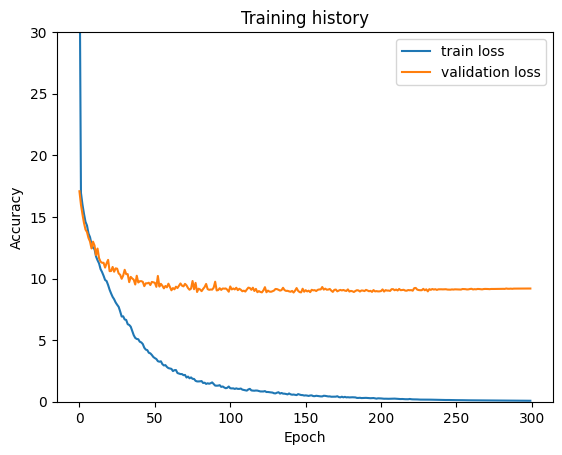

In [163]:
import matplotlib.pyplot as plt

#Plot training and validation accuracy
plt.plot(history["train_loss"], label='train loss')
plt.plot(history["valid_loss"], label='validation loss')

# Graph chars
plt.title('Training history')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend()
plt.ylim([0, 30]);
print(best_valid_loss)

IndexError: list index out of range

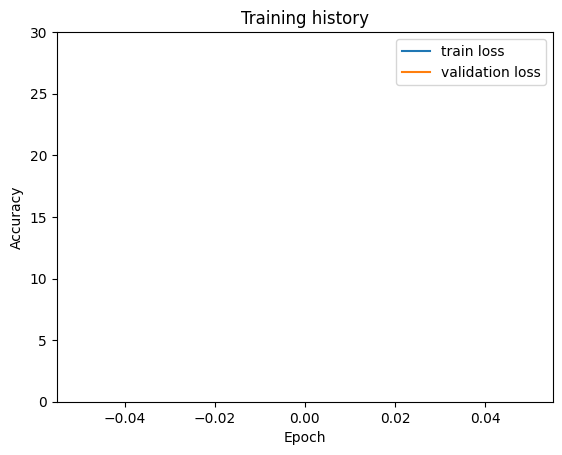

In [164]:
plt.plot(history["train_loss"][1500:1800], label='train loss')
plt.plot(history["valid_loss"][1500:1800], label='validation loss')

# Graph chars
plt.title('Training history')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend()
plt.ylim([0, 30]);
print(history["losses"][5])

In [ ]:
def prevision_mocap(model, input, device, max_output_length):
    model.eval()
    with torch.no_grad():
        input["pose"] = (torch.tensor(input["pose"]))
        input["pose"] = (input["pose"].float()).to(device)
        
        hidden, cell = model.encoder(input["pose"])
        previsions = input["pose"][-1].tolist()

        concat_hidden = model.actionclassifier(input["input_ids"].to(device), input["attention_mask"].to(device))
        concat_hidden = concat_hidden.unsqueeze(0)

        hidden = torch.cat((concat_hidden, hidden), dim=2).to(model.device)
        # hidden = [n layers * n directions, batch size, 2*hidden dim]
        concat_cell = torch.zeros(1, hidden.shape[1], 768).to(model.device)
        cell = torch.cat((concat_cell, cell), dim=2).to(model.device)
        # cell = [n layers * n directions, batch size, 2*hidden dim]

        for _ in range(max_output_length):
            inputs_tensor = torch.tensor([previsions[-1]]).to(device)

            output, hidden, cell = model.decoder(inputs_tensor, hidden, cell)
            output = output.tolist()
            previsions.append(output[0])
    
    del previsions[0]
    return np.array(previsions)


In [ ]:
rand_x = random.randint(0, len(dataset_copy["pose"]))

input_mocap = np.array(dataset_copy["pose"][rand_x][:50])

deleted = input_mocap[:, indexes_to_exclude]

input_mocap_test = np.delete(input_mocap, indexes_to_exclude, axis=1)

expected_output_mocap = np.array(dataset_copy["pose"][rand_x][-25:])

test = {'pose': [input_mocap_test], 'description': [dataset_copy["description"][rand_x]]}
test = pd.DataFrame(test)
input_dataloader = get_data_loader(test, 1, MAX_LEN)

input = next(iter(input_dataloader))

prevision = prevision_mocap(
    model,
    input,
    device,
    max_output_length = expected_output_mocap.shape[0]
)

for i, column in enumerate(deleted[-25:].T):
    prevision = np.insert(prevision, indexes_to_exclude[i], column, axis=1)

input_mocap = input_mocap.reshape(50, 24, 3)
print(input_mocap.shape)

expected_output_mocap = expected_output_mocap.reshape(25, 24, 3)
print(expected_output_mocap.shape)

prevision = prevision.reshape(25, 24, 3)
print(prevision.shape)

/tmp/ipykernel_235049/1205961236.py:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  input["pose"] = (torch.tensor(input["pose"]))


RuntimeError: Sizes of tensors must match except in dimension 2. Expected size 1 but got size 4 for tensor number 1 in the list.

In [ ]:

input_mocap = kine.compute_fk(input_mocap, apply_root_rotation=True)
expected_output_mocap = kine.compute_fk(expected_output_mocap, apply_root_rotation=True)
prevision = kine.compute_fk(prevision, apply_root_rotation=True)

motions_list = [[input_mocap], [expected_output_mocap, prevision]]
subplot_ids = [[0], [0,1]]
subplot_titles = [['Input_mocap'], ['Expected_output_mocap', 'Prevision']]
camera_orientations = [[CameraOrientation(100, 20)], [CameraOrientation(100, 20), CameraOrientation(100, 20)]]

pose_animation(motions_list[0], SmplConstants.PARENTS, animation_framerate = 25, subplot_ids=subplot_ids[0], 
               camera_orientations=camera_orientations[0], subplot_titles=subplot_titles[0],
               fig_opts={'dpi':90}, animation_mode=AnimationMode.HTML)

pose_animation(motions_list[1], SmplConstants.PARENTS, animation_framerate = 25, subplot_ids=subplot_ids[1], 
               camera_orientations=camera_orientations[1], subplot_titles=subplot_titles[1],
               animation_mode=AnimationMode.HTML)